# Imports

In [1]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore', SyntaxWarning)

from satpy.scene import Scene
from satpy.utils import debug_on

from datetime import datetime

from glob import glob

import hvplot.xarray

import panel as pn

## Starting to create satpy scenes

In [ ]:
sat_files = glob("input/G16_ABI-L1b-RadC/*")
sat_files

['input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C16_G16_s20232561536173_e20232561538557_c20232561539036.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C13_G16_s20232561536173_e20232561538557_c20232561539004.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C14_G16_s20232561536173_e20232561538546_c20232561538592.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C06_G16_s20232561536173_e20232561538551_c20232561539011.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C01_G16_s20232561536173_e20232561538548_c20232561538585.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C12_G16_s20232561536173_e20232561538552_c20232561539031.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C05_G16_s20232561536173_e20232561538546_c20232561539016.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C03_G16_s20232561536173_e20232561538546_c20232561538589.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C02_G16_s20232561536173_e20232561538546_c20232561538578.nc',
 'input/G16_ABI-L1b-RadF/OR_ABI-L1b-RadC-M6C04_G16_s202325615361

In [5]:
scn = Scene(filenames = sat_files, reader='abi_l1b')

dataset_names = scn.all_dataset_names()

#print(dataset_names)

In [7]:
scn.load([f'C{x:02d}' for x in range(1, 17)])

In [8]:
band_select = pn.widgets.Select(name='Band name', options=dataset_names)

In [9]:
def get_singleband_plot(bandname=None):
    
    scn.load([bandname])
    result = scn[bandname]
    interactive_plot = result.hvplot.image().opts(title=bandname)

    return interactive_plot

In [10]:
band_iplot = pn.bind(get_singleband_plot,bandname=band_select)

In [11]:
template = pn.template.MaterialTemplate(
    #site="",
    title="Visualize GOES-R data",
)



template.main.append(
         pn.Row(
            band_select,
             band_iplot
            #sizing_mode='stretch_both'
            )
        )

In [51]:
template#.servable()

MaterialTemplate
    [js_area] HTML(None, height=0, margin=0, sizing_mode='fixed', width=0)
    [actions] MaterialTemplateActions()
    [browser_info] BrowserInfo(dark_mode=False, device_pixel_ratio=2, language='en-US', timezone='America/Denver', timezone_offset=360, webdriver=False)
    [busy_indicator] LoadingSpinner(height=20, width=20)
    [main-140268869570064] Row
        [0] Select(name='Band name', options=['C01', 'C02', ...], value='C07')
        [1] ParamFunction(function, _pane=HoloViews, defer_load=False)

In [14]:
!panel serve 06_geosat_interactive_viz.ipynb

2024-06-13 19:40:51,059 Starting Bokeh server version 3.4.1 (running on Tornado 6.4)
2024-06-13 19:40:51,059 Cannot start Bokeh server, port 5006 is already in use


In [18]:
print(scn.available_composite_names())

['24h_microphysics', 'airmass', 'ash', 'cimss_cloud_type', 'cimss_cloud_type_raw', 'cimss_green', 'cimss_green_sunz', 'cimss_green_sunz_rayleigh', 'cimss_true_color', 'cimss_true_color_sunz', 'cimss_true_color_sunz_rayleigh', 'cira_day_convection', 'cira_fire_temperature', 'cloud_phase', 'cloud_phase_distinction', 'cloud_phase_distinction_raw', 'cloud_phase_raw', 'cloudtop', 'color_infrared', 'colorized_ir_clouds', 'convection', 'day_microphysics', 'day_microphysics_abi', 'day_microphysics_eum', 'dust', 'fire_temperature_awips', 'fog', 'geo_color', 'geo_color_background_with_low_clouds', 'geo_color_high_clouds', 'geo_color_low_clouds', 'geo_color_night', 'green', 'green_crefl', 'green_nocorr', 'green_raw', 'green_snow', 'highlight_C14', 'ir108_3d', 'ir_cloud_day', 'land_cloud', 'land_cloud_fire', 'natural_color', 'natural_color_nocorr', 'natural_color_raw', 'natural_color_raw_with_night_ir', 'night_fog', 'night_ir_alpha', 'night_ir_with_background', 'night_ir_with_background_hires', 'n

In [15]:
bandname = 'airmass'
scn.load([bandname])
result = scn[bandname]


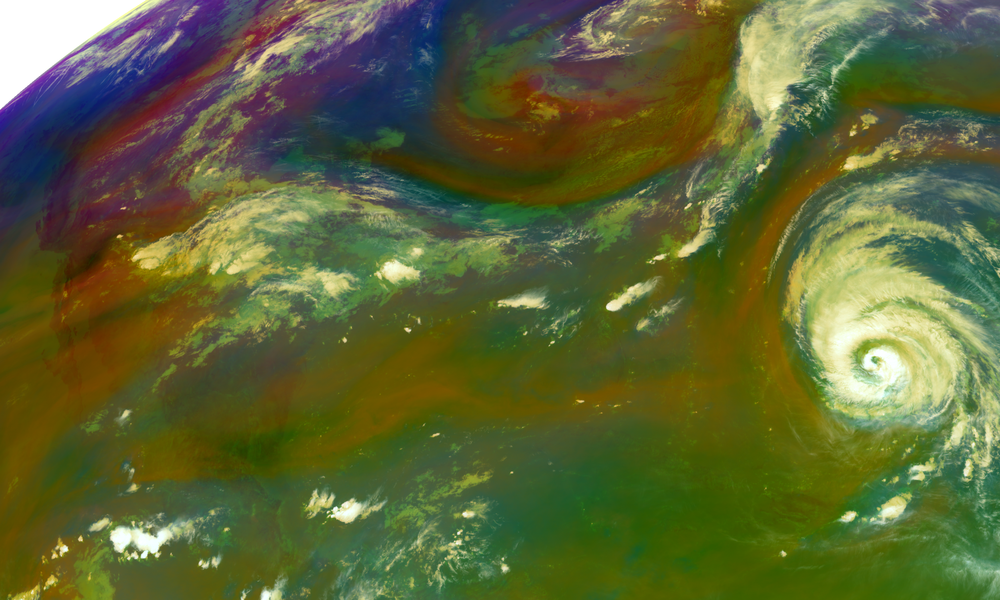

In [19]:
scn.show(bandname)

In [21]:
scn[bandname].load()

<xarray.DataArray 'where-3262856e8a6b458d9b6f6c38ee986f6f' (bands: 3, y: 1500,
                                                            x: 2500)> Size: 45MB
array([[[       nan,        nan,        nan, ..., -17.415085,
         -17.415085, -17.53238 ],
        [       nan,        nan,        nan, ..., -17.356293,
         -17.378647, -17.356293],
        [       nan,        nan,        nan, ..., -17.334122,
         -17.518936, -17.509933],
        ...,
        [-16.993744, -16.988281, -17.110046, ..., -19.241013,
         -19.397476, -19.458893],
        [-17.045685, -17.015533, -16.948532, ..., -19.386902,
         -19.722717, -19.554169],
        [-16.985504, -17.112915, -17.0112  , ..., -19.680054,
         -19.74176 , -19.69461 ]],

       [[       nan,        nan,        nan, ..., -26.991638,
         -27.100525, -27.36145 ],
        [       nan,        nan,        nan, ..., -26.959595,
         -26.957428, -27.104584],
        [       nan,        nan,        nan, ..., -27.06836 ,
         -27.138763, -27.321625],
...
        [-24.318848, -24.029419, -24.442993, ..., -20.62384 ,
         -20.738892, -20.707458],
        [-24.16095 , -24.067444, -24.637238, ..., -21.092163,
         -21.08142 , -21.019562],
        [-24.414276, -24.429504, -24.496674, ..., -21.327423,
         -21.39917 , -21.24582 ]],

       [[       nan,        nan,        nan, ..., 229.05138 ,
         229.05138 , 229.05138 ],
        [       nan,        nan,        nan, ..., 229.05138 ,
         228.97017 , 229.05138 ],
        [       nan,        nan,        nan, ..., 229.13234 ,
         228.88873 , 229.13234 ],
        ...,
        [242.50034 , 242.81036 , 242.86176 , ..., 237.13835 ,
         237.2613  , 237.19989 ],
        [242.4484  , 242.91306 , 243.06645 , ..., 237.68777 ,
         237.6272  , 237.56653 ],
        [242.55222 , 243.11743 , 243.21915 , ..., 237.9888  ,
         238.1084  , 237.92883 ]]], dtype=float32)
Coordinates:
    crs      object 8B PROJCRS["unknown",BASEGEOGCRS["unknown",DATUM["Unknown...
  * y        (y) float64 12kB 4.588e+06 4.586e+06 ... 1.586e+06 1.584e+06
  * x        (x) float64 20kB -3.626e+06 -3.624e+06 ... 1.38e+06 1.382e+06
  * bands    (bands) <U1 12B 'R' 'G' 'B'
Attributes: (12/27)
    ancillary_variables:     []
    grid_mapping:            goes_imager_projection
    production_site:         WCDAS
    platform_shortname:      G16
    standard_name:           airmass
    scan_mode:               M6
    ...                      ...
    wavelength:              None
    name:                    airmass
    _satpy_id:               DataID(name='airmass', resolution=2000)
    prerequisites:           [DataQuery(name='_airmass_dep_0'), DataQuery(nam...
    optional_prerequisites:  []
    mode:                    RGB

In [16]:
result

<xarray.DataArray 'where-3262856e8a6b458d9b6f6c38ee986f6f' (bands: 3, y: 1500,
                                                            x: 2500)> Size: 45MB
dask.array<where, shape=(3, 1500, 2500), dtype=float32, chunksize=(1, 1250, 1250), chunktype=numpy.ndarray>
Coordinates:
    crs      object 8B PROJCRS["unknown",BASEGEOGCRS["unknown",DATUM["Unknown...
  * y        (y) float64 12kB 4.588e+06 4.586e+06 ... 1.586e+06 1.584e+06
  * x        (x) float64 20kB -3.626e+06 -3.624e+06 ... 1.38e+06 1.382e+06
  * bands    (bands) <U1 12B 'R' 'G' 'B'
Attributes: (12/27)
    ancillary_variables:     []
    grid_mapping:            goes_imager_projection
    production_site:         WCDAS
    platform_shortname:      G16
    standard_name:           airmass
    scan_mode:               M6
    ...                      ...
    wavelength:              None
    name:                    airmass
    _satpy_id:               DataID(name='airmass', resolution=2000)
    prerequisites:           [DataQuery(name='_airmass_dep_0'), DataQuery(nam...
    optional_prerequisites:  []
    mode:                    RGB

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


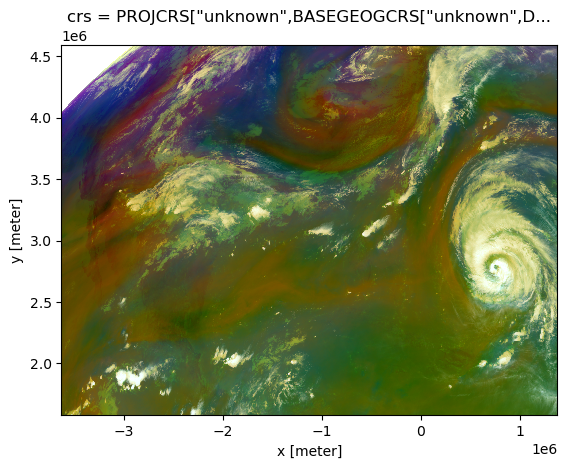

In [24]:
result.data.plot.imshow()

In [33]:
da = result.data.load()

In [38]:
da["bands"] = [0,1,2]

In [44]:
import numpy as np

In [45]:
np.floor(da*255)

<xarray.DataArray (bands: 3, y: 1500, x: 2500)> Size: 45MB
array([[[ nan,  nan,  nan, ...,  83.,  83.,  82.],
        [ nan,  nan,  nan, ...,  84.,  83.,  84.],
        [ nan,  nan,  nan, ...,  84.,  82.,  82.],
        ...,
        [ 87.,  87.,  86., ...,  66.,  64.,  64.],
        [ 87.,  87.,  88., ...,  64.,  61.,  63.],
        [ 87.,  86.,  87., ...,  62.,  61.,  61.]],

       [[ nan,  nan,  nan, ...,  82.,  82.,  80.],
        [ nan,  nan,  nan, ...,  82.,  83.,  82.],
        [ nan,  nan,  nan, ...,  82.,  82.,  81.],
        ...,
        [ 96.,  97.,  95., ..., 115., 114., 114.],
        [ 97.,  97.,  94., ..., 112., 113., 113.],
        [ 95.,  95.,  95., ..., 111., 111., 112.]],

       [[ nan,  nan,  nan, ..., 106., 106., 106.],
        [ nan,  nan,  nan, ..., 106., 107., 106.],
        [ nan,  nan,  nan, ..., 106., 108., 106.],
        ...,
        [ 10.,   7.,   7., ...,  48.,  47.,  48.],
        [ 10.,   7.,   6., ...,  44.,  45.,  45.],
        [  9.,   5.,   4., ...,  42.,  41.,  43.]]], dtype=float32)
Coordinates:
    crs      object 8B PROJCRS["unknown",BASEGEOGCRS["unknown",DATUM["Unknown...
  * y        (y) float64 12kB 4.588e+06 4.586e+06 ... 1.586e+06 1.584e+06
  * x        (x) float64 20kB -3.626e+06 -3.624e+06 ... 1.38e+06 1.382e+06
  * bands    (bands) int64 24B 0 1 2

In [49]:
np.floor(da*255).hvplot.rgb(x='x',y='y',bands='bands',colorbar=True,rasterize=True,dynamic=True)

:DynamicMap   []
   :RGB   [x,y]   (R,G,B)

In [22]:
from satpy.composites import get_enhanced_image

result = get_enhanced_image(scn[bandname])
